#**Import Dependencies**

In [ ]:
!pip install -q transformers accelerate peft diffusers

In [ ]:
import torch
from diffusers import StableDiffusionPipeline, AutoPipelineForImage2Image
from diffusers.utils import load_image

/usr/local/lib/python3.10/dist-packages/diffusers/models/transformers/transformer_2d.py:34: FutureWarning: `Transformer2DModelOutput` is deprecated and will be removed in version 1.0.0. Importing `Transformer2DModelOutput` from `diffusers.models.transformer_2d` is deprecated and this will be removed in a future version. Please use `from diffusers.models.modeling_outputs import Transformer2DModelOutput`, instead.
  deprecate("Transformer2DModelOutput", "1.0.0", deprecation_message)
/usr/local/lib/python3.10/dist-packages/diffusers/models/vq_model.py:20: FutureWarning: `VQEncoderOutput` is deprecated and will be removed in version 0.31. Importing `VQEncoderOutput` from `diffusers.models.vq_model` is deprecated and this will be removed in a future version. Please use `from diffusers.models.autoencoders.vq_model import VQEncoderOutput`, instead.
  deprecate("VQEncoderOutput", "0.31", deprecation_message)
/usr/local/lib/python3.10/dist-packages/diffusers/models/vq_model.py:25: FutureWarning

In [ ]:
import matplotlib.pyplot as plt
def resized_image(image):
    if image.size[0] < 512 or image.size[1] < 512:
        return image
    else:
        width, height = int(image.size[0] / 1.5), int(image.size[1] / 1.5)
        image = image.resize((width, height))
        return resized_image(image)

def make_image_grid(images, titles, rows, cols, figsize=(20, 10), resize=None):
    fig, axes = plt.subplots(rows, cols, figsize=figsize)
    for ax, img, title in zip(axes.flatten(), images, titles):
        if resize:
            img = img.resize((resize, resize))
        ax.imshow(img)
        ax.set_title(title, fontdict={'fontsize': 16, 'fontweight': 'bold'})
        ax.axis('off')
    plt.tight_layout(pad=0.5, w_pad=0.2, h_pad=0.2)
    plt.show()


In [ ]:
def generated_image_img_to_img(prompt, input_image_path):
  image = load_image(input_image_path)
  resized_img = resized_image(image)
  image_output_base = base_pipeline_img_to_img(prompt, image=resized_img, strength=0.5).images[0]
  image_output_lora1 = lora_pipeline_img_to_img(prompt, image=resized_img, strength=0.5).images[0]
  image_output_lora2 = lora_pipeline_img_to_img(prompt, image=resized_img, strength=0.5).images[0]
  image_output_lora3 = lora_pipeline_img_to_img(prompt, image=resized_img, strength=0.5).images[0]
  image_output_lora4 = lora_pipeline_img_to_img(prompt, image=resized_img, strength=0.5).images[0]
  print(f"Prompt : {prompt}")
  titles = ['Input Image', 'Before Fine-Tuning', 'After Fine-Tuning', 'After Fine-Tuning', 'After Fine-Tuning', 'After Fine-Tuning']
  images = [resized_img, image_output_base, image_output_lora1, image_output_lora2, image_output_lora3, image_output_lora4]
  make_image_grid(images, titles, rows=2, cols=3)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#**Image to Image Model Loading**

In [ ]:
base_model_path = '/content/drive/MyDrive/Interior_Design/base_model'
lora_weight_path = '/content/drive/MyDrive/Interior_Design/fine_tuned_lora_weight'

In [ ]:
base_pipeline_img_to_img = AutoPipelineForImage2Image.from_pretrained(base_model_path, torch_dtype=torch.float16, use_safetensors=True)
base_pipeline_img_to_img = base_pipeline_img_to_img.to("cuda")
base_pipeline_img_to_img.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
lora_pipeline_img_to_img = AutoPipelineForImage2Image.from_pretrained(base_model_path, torch_dtype=torch.float16, use_safetensors=True)
lora_pipeline_img_to_img.load_lora_weights(lora_weight_path, weight_name="pytorch_lora_weights.safetensors")
lora_pipeline_img_to_img = lora_pipeline_img_to_img.to("cuda")
lora_pipeline_img_to_img.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

#**Image Type 1**

  0%|          | 0/25 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with textured paint or wallpaper, sofa with sleek, minimalist design


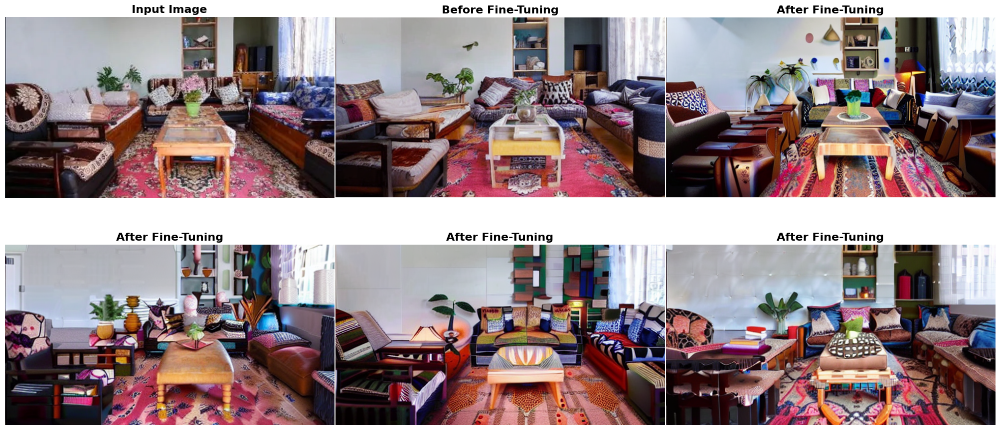

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/old_house1.PNG'
prompt = """realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with textured paint or wallpaper, sofa with sleek, minimalist design"""
generated_image_img_to_img(prompt, input_image_path)

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with textured paint, sofa with sleek, minimalist design


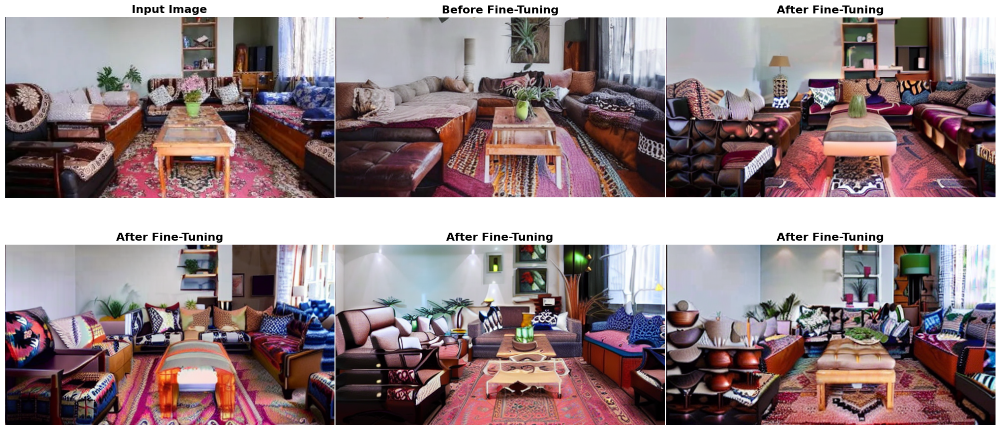

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/old_house1.PNG'
prompt = """realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with textured paint, sofa with sleek, minimalist design"""
generated_image_img_to_img(prompt, input_image_path)

#**Image Type 2**

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with textured paint, sofa with sleek, minimalist design, Large, floor-to-ceiling windows to allow natural light


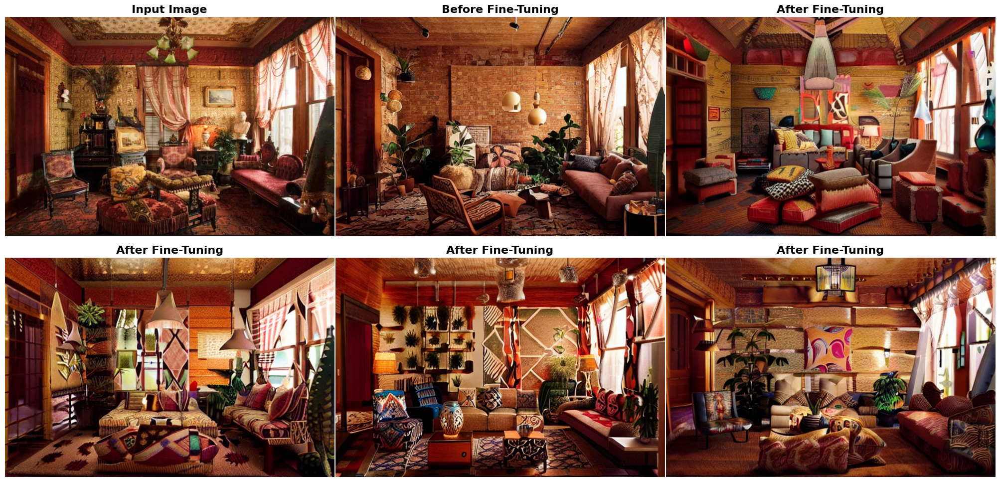

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/a7ff6736349fb03902e65c655d898736.jpg'
prompt = """realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with textured paint, sofa with sleek, minimalist design, Large, floor-to-ceiling windows to allow natural light"""
generated_image_img_to_img(prompt, input_image_path)

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with textured paint, white sofa with sleek, minimalist design, Large floor-to-ceiling windows to allow natural light


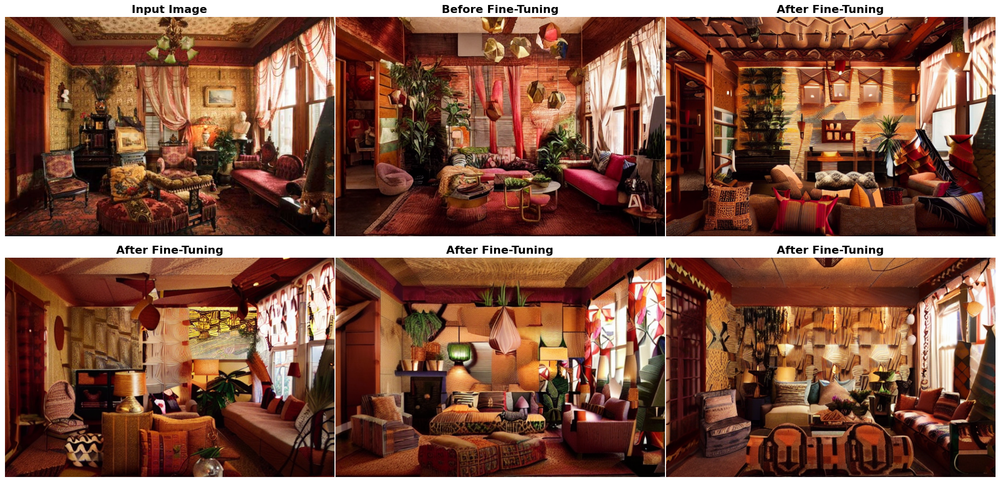

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/a7ff6736349fb03902e65c655d898736.jpg'
prompt = """realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with textured paint, white sofa with sleek, minimalist design, Large floor-to-ceiling windows to allow natural light"""
generated_image_img_to_img(prompt, input_image_path)

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : realistic living room with natural light, cushions with mix of textures and patterns, rug with white solid color, pendant lights, floor lamps with 
modern design, an accent wall with textured paint, white sofa with sleek, minimalist design, Large floor-to-ceiling windows to allow natural light, 
furniture with combination of wood, metal, and glass


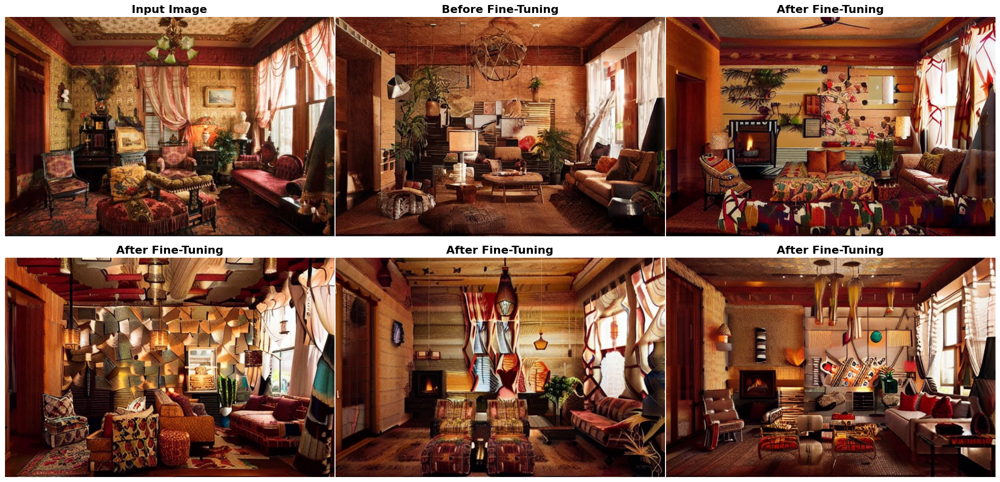

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/a7ff6736349fb03902e65c655d898736.jpg'
prompt = """realistic living room with natural light, cushions with mix of textures and patterns, rug with white solid color, pendant lights, floor lamps with
modern design, an accent wall with textured paint, white sofa with sleek, minimalist design, Large floor-to-ceiling windows to allow natural light,
furniture with combination of wood, metal, and glass"""
generated_image_img_to_img(prompt, input_image_path)

#**Image Type 3**

  0%|          | 0/25 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : Natural Light Focus, light-colored wood floor or light-toned tiles for a clean and contemporary look.
Hang modern artwork or decorative mirrors on the walls, Introduce pops of color with throw pillows or decorative objects,
Paint the walls a bright white or a light neutral color to create a sense of openness and airiness


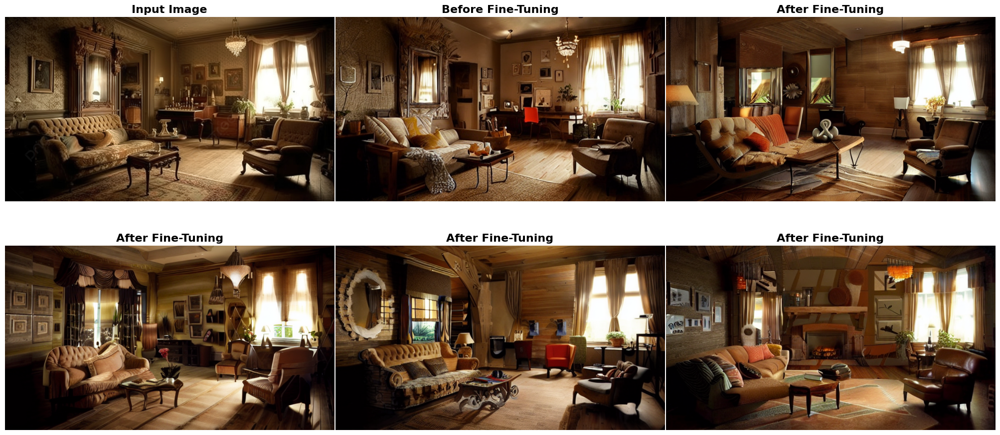

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/pngtree-victorian-furniture-interior-homes-picture-image_3053098.jpg'
prompt = """Natural Light Focus, light-colored wood floor or light-toned tiles for a clean and contemporary look.
Hang modern artwork or decorative mirrors on the walls, Introduce pops of color with throw pillows or decorative objects,
Paint the walls a bright white or a light neutral color to create a sense of openness and airiness"""
generated_image_img_to_img(prompt, input_image_path)

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with textured paint, sofa with sleek, minimalist design, Large, floor-to-ceiling windows to allow 
natural light


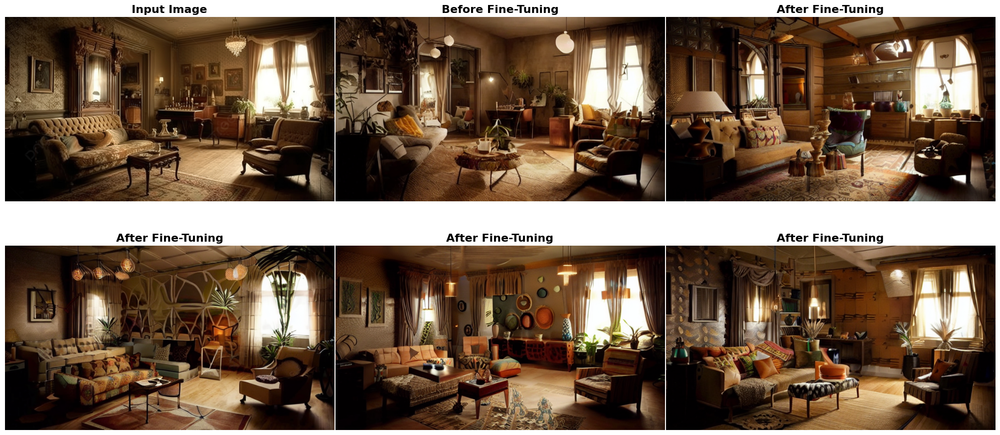

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/pngtree-victorian-furniture-interior-homes-picture-image_3053098.jpg'
prompt = """realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with textured paint, sofa with sleek, minimalist design, Large, floor-to-ceiling windows to allow
natural light"""
generated_image_img_to_img(prompt, input_image_path)

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, pendant lights, floor lamps 
with modern design, an accent wall with solid white paint, brouwn sofa with sleek, minimalist design, Large, floor-to-ceiling windows to allow 
natural light, Mix of smooth and textured surfaces for visual interest


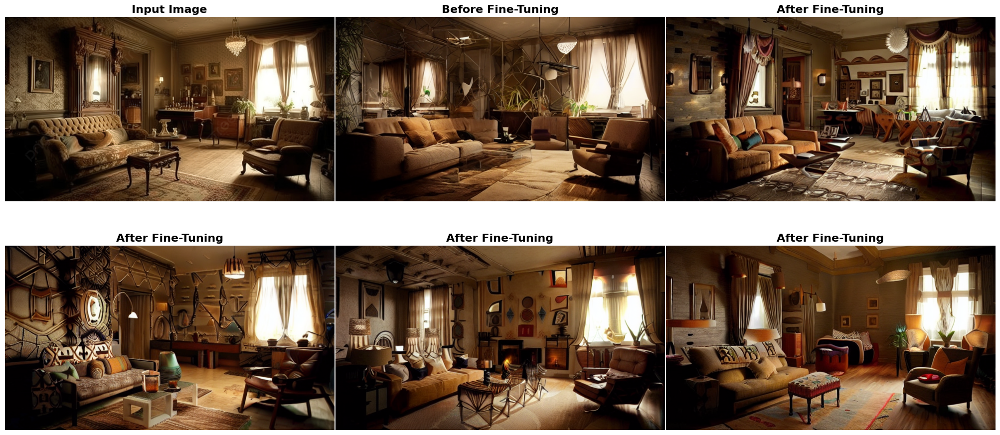

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/pngtree-victorian-furniture-interior-homes-picture-image_3053098.jpg'
prompt = """realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, pendant lights, floor lamps
with modern design, an accent wall with solid white paint, brouwn sofa with sleek, minimalist design, Large, floor-to-ceiling windows to allow
natural light, Mix of smooth and textured surfaces for visual interest"""
generated_image_img_to_img(prompt, input_image_path)

#**Image Type 4**

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : Natural Light Focus, light-colored wood floor or light-toned tiles for a clean and contemporary look. Hang modern artwork or decorative mirrors 
on the walls, Introduce pops of color with throw pillows or decorative objects, Paint the walls a bright white or a light neutral color to create a sense 
of openness and airiness


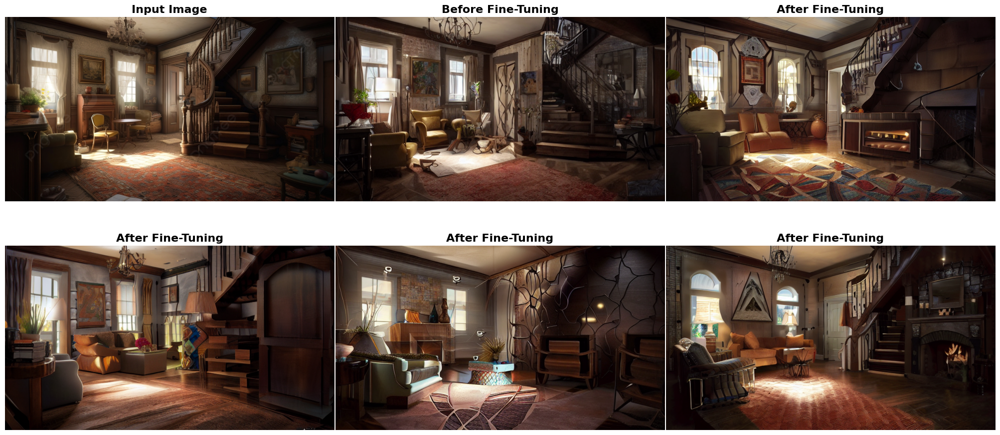

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/pngtree-an-old-fashioned-house-with-a-staircase-and-a-couch-picture-image_2743031.jpg'
prompt = """Natural Light Focus, light-colored wood floor or light-toned tiles for a clean and contemporary look. Hang modern artwork or decorative mirrors
on the walls, Introduce pops of color with throw pillows or decorative objects, Paint the walls a bright white or a light neutral color to create a sense
of openness and airiness"""
generated_image_img_to_img(prompt, input_image_path)

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : realistic living room with natural light, rug with geometric patterns, plants for a touch of greenery, pendant lights, floor lamps with modern 
design, an accent wall with textured paint, Large floor-to-ceiling windows to allow natural light, stairs with white paint


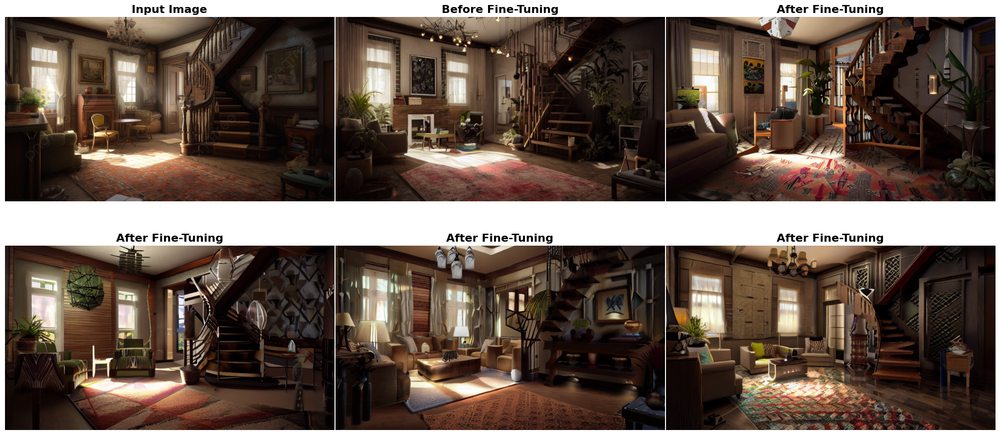

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/pngtree-an-old-fashioned-house-with-a-staircase-and-a-couch-picture-image_2743031.jpg'
prompt = """realistic living room with natural light, rug with geometric patterns, plants for a touch of greenery, pendant lights, floor lamps with modern
design, an accent wall with textured paint, Large floor-to-ceiling windows to allow natural light, stairs with white paint"""
generated_image_img_to_img(prompt, input_image_path)

In [ ]:
torch.cuda.empty_cache()

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

Prompt : realistic room with natural light, rug with solid white color, plants for a touch of greenery, pendant lights, floor lamps with modern design, an 
accent wall with solid yellow paint, Large floor-to-ceiling windows to allow natural light, stairs with white color, furniture with combination of wood, metal, and glass


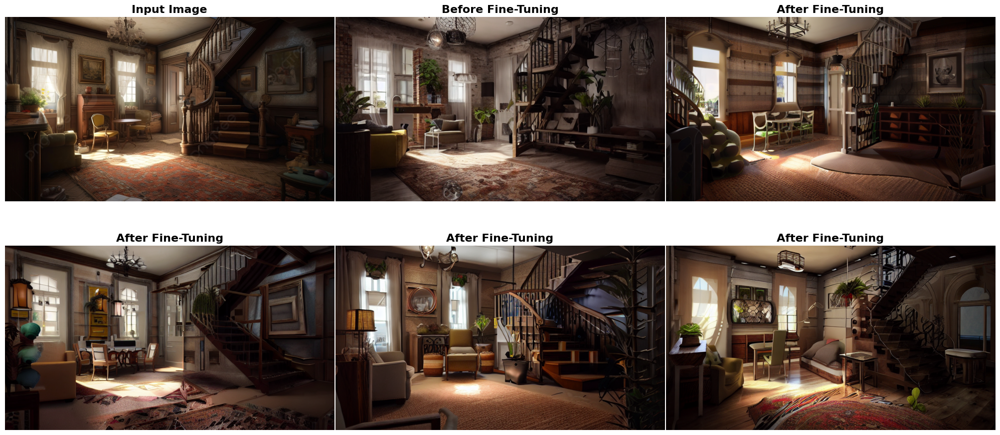

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/pngtree-an-old-fashioned-house-with-a-staircase-and-a-couch-picture-image_2743031.jpg'
prompt = """realistic room with natural light, rug with solid white color, plants for a touch of greenery, pendant lights, floor lamps with modern design, an
accent wall with solid yellow paint, Large floor-to-ceiling windows to allow natural light, stairs with white color, furniture with combination of wood, metal, and glass"""
generated_image_img_to_img(prompt, input_image_path)

#**Image Type 5**

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/beautiful-castle-architecture.jpg'
prompt = """Natural Light Focus, light-colored wood floor or light-toned tiles for a clean and contemporary look, Hang modern artwork or decorative mirrors,
Paint the walls a bright white or a light neutral color to create a sense of openness and airiness"""
generated_image_img_to_img(prompt, input_image_path)

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/beautiful-castle-architecture.jpg'
prompt = """realistic living room with natural light, cushions with mix of textures and patterns, rug with geometric patterns, plants for a touch of greenery,
pendant lights, floor lamps with modern design, an accent wall with solid color paint, Large floor-to-ceiling windows to allow natural light,
modern decorative mirror"""
generated_image_img_to_img(prompt, input_image_path)

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/beautiful-castle-architecture.jpg'
prompt = """realistic living room with natural light, cushions with mix of textures and patterns, rug with solid white color, sofa with sleek, minimalist design,
pendant lights, floor lamps, an accent wall with solid color paint, Large floor-to-ceiling windows to allow natural light, modern decorative mirror"""
generated_image_img_to_img(prompt, input_image_path)

#**Image Type 6**

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/abandoned-room-with-table-middle-shelves-against-wall-near-window.jpg'
prompt = """Natural Light Focus, light-colored wood floor or light-toned tiles for a clean and contemporary look.
Hang modern artwork or decorative mirrors on the walls, Introduce pops of color with throw pillows or decorative objects,
Paint the walls a bright white or a light neutral color to create a sense of openness and airiness"""
generated_image_img_to_img(prompt, input_image_path)

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/abandoned-room-with-table-middle-shelves-against-wall-near-window.jpg'
prompt = """realistic room with natural light, rug with geometric patterns, plants for a touch of greenery, pendant lights, floor lamps with
modern design, an accent wall with textured paint, Large floor-to-ceiling windows to allow natural light, furniture with combination of wood, metal, and glass"""
generated_image_img_to_img(prompt, input_image_path)

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/abandoned-room-with-table-middle-shelves-against-wall-near-window.jpg'
prompt = """realistic room with natural light, rug with geometric patterns, plants for a touch of greenery, pendant lights, floor lamps with modern design,
an accent wall with solid white color paint, Large floor-to-ceiling windows to allow natural light, furniture with combination of wood, metal, and glass"""
generated_image_img_to_img(prompt, input_image_path)

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/abandoned-room-with-table-middle-shelves-against-wall-near-window.jpg'
prompt = """realistic room with natural light, rug with geometric patterns, plants for a touch of greenery, pendant lights with modern design,
an accent wall with solid white color paint, Large floor-to-ceiling windows to allow natural light, furniture with combination of wood, metal, and glass,
modern paintings on walls"""
generated_image_img_to_img(prompt, input_image_path)

#**Image Type 7**

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/cozy-rustic-living-room-with-modern-elegance-antique-decor-generated-by-ai.jpg'
prompt = """realistic room with natural light, rug with geometric patterns, chair with solid color, floor lamps with modern design,
an accent wall with solid color paint, Large windows to allow natural light, Mix of smooth and textured surfaces for visual interest,
furniture with combination of wood, metal, and glass"""
generated_image_img_to_img(prompt, input_image_path)

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/cozy-rustic-living-room-with-modern-elegance-antique-decor-generated-by-ai.jpg'
prompt = """realistic room with natural light, rug with geometric patterns, chair with solid color, floor lamps with modern design,
an accent wall with solid color paint, Large windows to allow natural light, Mix of smooth and textured surfaces for visual interest,
furniture with combination of wood, metal, and glass, room with bright light"""
generated_image_img_to_img(prompt, input_image_path)

#**Image Type 8**

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/old-atelier-tools-carpenter.jpg'
prompt = """realistic room with natural light, rug with geometric patterns, chair and table with solid color, floor lamps with modern design,
an accent wall with solid color paint, Large windows to allow natural light, Mix of smooth and textured surfaces for visual interest,
furniture with combination of wood, metal, and glass, room with bright light"""
generated_image_img_to_img(prompt, input_image_path)

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/old-atelier-tools-carpenter.jpg'
prompt = """realistic room with natural light, rug with geometric patterns, chair and table with solid color, an accent wall with solid color paint,
Large windows to allow natural light, pendant lights, floor lamps with modern design, room with bright light"""
generated_image_img_to_img(prompt, input_image_path)

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/old-atelier-tools-carpenter.jpg'
prompt = """realistic room with natural light, rug with solid color, chair and table with solid color,
large wooden and glass windows to allow natural light, pendant lights, floor lamps with modern design, room with bright light"""
generated_image_img_to_img(prompt, input_image_path)

In [ ]:
input_image_path = '/content/drive/MyDrive/Interior_Design/original images/old-atelier-tools-carpenter.jpg'
prompt = """realistic room with natural light, rug with solid color, chair and table with solid color,
large wooden and glass windows to allow natural light, pendant lights, floor lamps with modern design, room with bright light"""
generated_image_img_to_img(prompt, input_image_path)